---
## [이용 가이드]

총 4개의 셀로 구성되어져 있음. <mark>셀 실행 전 아래 url을 참고하여 PC 세팅 필요.</mark>
https://cheershennah.tistory.com/141

#### 첫번째 셀 : 기본설정
- 사용자 설정 있음

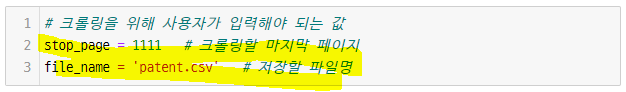

#### 두번째 셀 : 크롤링
- 사용자 설정 없음
- desh 기호는 개당 1초를 의미

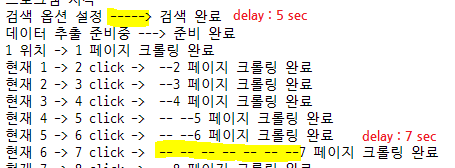

#### 세번째 셀 : 데이터 저장
- 사용자 설정 없음

#### 네번째 셀 : 저장된 데이터 확인
- 윈도우에서 인코딩 형식 디스매칭으로 글자 깨질 때 사용하기에 유용
- 인덱스 번호와 게시물 번호 매칭하여 데이터 누락/중복 확인 유용 (사진참고)

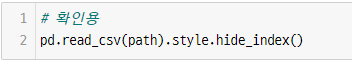

---

In [1]:
# 첫번째 셀 : 기본설정
# 크롤링을 위해 사용자가 입력해야 되는 값
stop_page = 1111   # 크롤링할 마지막 페이지
file_name = 'patent.csv'   # 저장할 파일명

In [ ]:
# 두번째 셀 : 크롤링
from selenium import webdriver
from selenium.webdriver.support.ui import Select
from selenium.webdriver.common.keys import Keys
from IPython.display import Image
from bs4 import BeautifulSoup
import pandas as pd
from datetime import datetime
import time
import os

# 함수 : 딜레이
def delay(text, sec):
    print(text, end=" ")
    for i in range(sec): print('-', end=""); time.sleep(1)

# 함수 : 사이트에서 제목/내용 크롤링
def contentCrawling():
    dom = BeautifulSoup(driver.page_source, 'html.parser')
    patent_list = dom.select('.search_section article')
    
    current_page = driver.find_element_by_css_selector('span.board_pager03 strong').text

    result = [
            {
                '제목': patent.select_one('.search_section_title h1 > a:nth-of-type(2)').text.strip(),
                '내용': patent.select_one('.search_txt').text.strip()
            }
            for patent in patent_list
    ]

    return int(current_page), result   # (크롤링한 페이지, 크롤링 결과) 반환

# 함수 : 저장할 파일 경로 찾기
def findPath(file_name):
    file_path = r'D:\DevRoot\StockHelper\dataset'
    file_name = file_name
    try: 
        path = os.path.join(file_path, file_name)
    except(Exception):
        file_path = 'C:\DeepLearning_Project\StockHelper\StockHelper\dataset'
        path = os.path.join(file_path, file_name)
        
    return path

print('프로그램 시작')
start = time.time()  # 시작 시간 저장

# 1. webdriver를 이용해 kipris 접속
driver_path = r'D:\DevRoot\download\chromedriver.exe'
try: 
    driver = webdriver.Chrome(driver_path)
except(Exception):
    driver_path = r'C:\DevRoot\download\chromedriver.exe'
    driver = webdriver.Chrome(driver_path)
finally:
    driver.get("http://kpat.kipris.or.kr/kpat/searchLogina.do?next=MainSearch")

# 2. 검색 옵션 설정
delay('검색 옵션 설정', 5)

# 2.1. 행정상태 변경
# defalut 해제 <- '전체' 클릭
driver.find_element_by_css_selector('form#leftside .release_list > span:nth-of-type(1) > input').click()
# 원하는 checkbox만 선택 <- '등록' 클릭
driver.find_element_by_css_selector('form#leftside .release_list > span:nth-last-of-type(1) > input').click()

# 2.2. 기간을 검색어로 입력
today = datetime.today().strftime("%Y%m%d")
decade = str(int(today) - int('00001000'))
driver.find_element_by_css_selector('.keyword').send_keys(f'GD=[{decade}~{today}]')
driver.find_element_by_css_selector('.input_btn img').click()

# 2.3. 90개씩 보기 선택
pageSel = 90   # 페이지당 게시물 개수 (30, 60, 90 중 택1)
select = Select(driver.find_element_by_id('opt28'))
select.select_by_value(str(pageSel))
driver.find_element_by_css_selector('#pageSel img').click()

print('> 검색 완료')

# 3. 데이터 추출
delay('데이터 추출 준비중', 3)
print('> 준비 완료')

page_num = 'span.board_pager03 a:nth-last-of-type({0})'   # target_page 구할 때 이용
# stop_page = 1111   # 크롤링할 마지막 페이지

# 첫 페이지 크롤링
result = []
current_page, data = contentCrawling()
result.extend(data)
print(f'{current_page} 위치 -> {current_page} 페이지 크롤링 완료')

# 페이지 이동하며 크롤링
while True:
    # 실행 종료
    if current_page >= stop_page: break
    
    # 데이터 추출
    for i in range(10, 0, -1):
        if current_page >= stop_page: break
            
        print(f'현재 {current_page}', end=" -> ")
        time.sleep(2)
        # 크롤링할 페이지(target_page)인 다음 페이지로 이동
        target_page = driver.find_element_by_css_selector(page_num.format(i))
        print(f'{target_page.text} click', end=" -> ")
        target_page.click()
        while True:
            try:
                click_page = driver.find_element_by_css_selector('span.board_pager03 strong').text
            except(Exception):
                dom = BeautifulSoup(driver.page_source, 'html.parser')
                patent_list = dom.select('.search_section article')

                click_page = driver.find_element_by_css_selector('span.board_pager03 strong').text
            if int(current_page) != int(click_page): break
            delay("", 2)  # 페이지 이동 안 하면 seelp()
        # 크롤링
        current_page, data = contentCrawling()
        result.extend(data)
        # 중간결과 반환
        print(f'{current_page} 페이지 크롤링 완료')
        
print('긁어온 데이터개수 :', len(result))
print('소요시간 :', int(time.time() - start) / 60, '분')  # 현재시각 - 시작시간 = 실행 시간
print('프로그램 종료')

프로그램 시작
검색 옵션 설정 -----> 검색 완료
데이터 추출 준비중 ---> 준비 완료
1 위치 -> 1 페이지 크롤링 완료
현재 1 -> 2 click ->  --2 페이지 크롤링 완료
현재 2 -> 3 click ->  --3 페이지 크롤링 완료
현재 3 -> 4 click ->  --4 페이지 크롤링 완료
현재 4 -> 5 click ->  -- --5 페이지 크롤링 완료
현재 5 -> 6 click ->  -- -- -- --6 페이지 크롤링 완료
현재 6 -> 7 click ->  -- --7 페이지 크롤링 완료
현재 7 -> 8 click ->  --8 페이지 크롤링 완료
현재 8 -> 9 click ->  --9 페이지 크롤링 완료
현재 9 -> 10 click ->  --10 페이지 크롤링 완료
현재 10 -> 다음 click ->  --11 페이지 크롤링 완료
현재 11 -> 12 click ->  -- -- -- --12 페이지 크롤링 완료
현재 12 -> 13 click ->  -- -- -- -- -- -- --13 페이지 크롤링 완료
현재 13 -> 14 click ->  -- --14 페이지 크롤링 완료
현재 14 -> 15 click ->  -- --15 페이지 크롤링 완료
현재 15 -> 16 click ->  -- -- --16 페이지 크롤링 완료
현재 16 -> 17 click ->  -- -- -- --17 페이지 크롤링 완료
현재 17 -> 18 click ->  --18 페이지 크롤링 완료
현재 18 -> 19 click ->  --19 페이지 크롤링 완료
현재 19 -> 20 click ->  --20 페이지 크롤링 완료
현재 20 -> 다음 click ->  --21 페이지 크롤링 완료
현재 21 -> 22 click ->  --22 페이지 크롤링 완료
현재 22 -> 23 click ->  --23 페이지 크롤링 완료
현재 23 -> 24 click ->  --24 페이지 크롤링 완료
현재 24 -> 25 cli

In [66]:
# 세번째 셀 : 데이터 저장
# 데이터 저장 : list -> df -> csv 저장
# file_name = 'patent.csv'   # 저장할 파일명
path = findPath(file_name)
pd.DataFrame(result, index=range(1, len(result) + 1)).to_csv(path, encoding='utf-8')

# 저장 결과 반환
if os.path.isfile(path):
    print('>>> 파일변환 완료:', datetime.today().strftime(("%Y-%m-%d %H:%M:%S")))
    print('>>> 저장위치:', path)
else: print('>>> 파일변환 실패')

>>> 파일변환 완료: 2021-12-02 16:49:56
>>> 저장위치: D:\DevRoot\StockHelper\dataset\patent.csv


In [55]:
# 네번째 셀 : 저장된 데이터 확인
path = findPath(file_name)
pd.read_csv(path).style.hide_index()

Unnamed: 0,제목,내용
1,골프 힙턴 타이밍 연습기(Golf Hip Turn Timing Trainer),"본 고안에 따른 골프 힙턴 타이밍 연습기는, 버클이 마련되어 허리에 착용되는 착용벨트, 착용벨트의 중앙부에 위치하며 착용벨트의 길이 방향에 따른 제1 끼움 통로를 제공하는 제1 끼움 고정부, 착용벨트에서 제1 끼움 고정부의 양측에 이격되어 위치하며 착용벨트의 길이 방향에 따른 제2 끼움 통로를 제공하는 복수의 제2 끼움 고정부, 및 착용벨트의 길이 방향을 따라 제1 끼움 고정부와 제2 끼움 고정부에 끼워져 위치 고정되며 어깨 너비보다 길게 마련된 힙턴 연동 스틱을 포함한다. 상기와 같은 본 고안은 골프 스윙에서 하체의 움직임인 힙턴이 상체의 팔과 손의 움직임과 연동되어 올바른 스윙 타이밍 연습이 가능하며, 잘못된 타이밍 발생 시 즉각적인 피드백이 제공되며, 허리에 착용이 용이하면서 힙턴에 따른 궤적을 정확하게 표현하여 스윙 오동작을 교정하는 장점을 제공한다."
2,절취 가능한 환자용 매트리스 커버(Cuttable patient mattress cover),"본 고안은 부직포층과 방수층으로 이루어지는 복수개의 시트부를 적층하여 절취 가능하도록 형성함으로써 최상부의 시트부가 오염될 경우 바로 절취하여 버릴 수 있으므로 매번 매트리스 커버를 교체해야 하는 번거로움을 줄일 수 있고, 환자 개인에 맞게 간편하게 교체할 수 있어 위생상 문제와 2차 감염 문제를 미연에 예방할 수 있도록 하는 절취 가능한 환자용 매트리스 커버를 제공한다. 본 고안은 매트리스(100)의 상면을 덮고, 절취 가능하도록 형성되는 시트부(21)가 복수개로 적층된 상면부(20)와; 상기 상면부(20)에 봉재되어 상기 매트리스(100)의 측면 높이만큼 연장되는 측면부(30)와; 상기 측면부(30)의 끝단에 형성되고, 상기 상면부(20)와 측면부(30)를 상기 매트리스(100)에 밀착시키기 위한 조임수단(40)을 포함하는 것을 특징으로 한다."
3,구이용 불판(Grill Plate For Roasting),"본 고안은 직화구이의 장점을 얻을 수 있는 동시에 그의 불편함을 개선할 수 있으며 일회용으로도 사용할 수 있는 구이용 불판에 관한 것이다. 그의 구성은, 조리물을 올려놓기 위한 것으로서 "" ""의 형태로 절곡 형성된 받침판; 절곡에 의해 상기 받침판의 양쪽 가장자리에서 상방향으로 연장되어 있는 날개판; 열원의 열기가 직접 통과될 수 있도록 상기 받침판 상에 슬릿(slit)의 형태로 마련되어 있는 복수 개의 열기통과공;을 포함하는 것을 특징으로 한다."
4,스케치북(sketchbook),"스케치북을 개시한다. 본 개시의 일 실시예에 의하면, 복수의 용지가 적층되어 구성되는 내지부; 내지부의 적어도 일면에 배치되는 표지부; 내지부의 중심을 지나면서 내지부의 단측변과 평행한 제1 중심축 또는 내지부의 중심을 지나면서 내지부의 단측변과 평행한 제2 중심축을 기준으로 하여 대칭되도록 형성되고, 내지부 및 표지부를 관통하도록 구성되는 복수의 관통홀; 및 복수의 관통홀을 통과할 수 있도록 구성되는 조절끈을 포함하되, 조절끈은, 복수의 관통홀의 적어도 일부를 통과한 상태에서, 제1 중심축을 중심으로 대칭되도록 형성되고, 양 단부가 서로 연결되어 고정될 수 있도록 구성되는 것을 특징으로 하는 스케치북을 제공한다."
5,유지 보수성이 향상된 지반굴착용 교반 비트의 바이트 팁(BITE TIP OF AGITATING BIT FOR GROUND EXCAVATION WITH IMPROVED MAINTAINABILITY),"교반 날개로부터 교체가 간편한 동시에, 강도가 크게 향상되어 교체 비용을 절감시키고 유지 보수성이 크게 향상되도록 하는 교반 비트의 교반 날개에 부착되는 바이트 팁의 새로운 구조를 제안한다. 본 고안의 일 실시예에 따른 유지 보수성이 향상된 지반굴착용 교반 비트의 바이트 팁은, 원통형의 본체의 외주면을 따라서 일체 형성된 교반 날개의 단측에 결합되는 결합부; 결합부로부터 연장 형성되는 바디; 바디의 표면에 초경용사 방식으로 형성된 초경용사 강화부; 및 바디의 결합부와 반대측 단부의 양 측면에 부착된 한 쌍의 초경합금 재질의 초경 보강부;를 포함하는 것을 특징으로 한다."
6,물배출구 오염이 방지되는 편향물통뚜껑(Deflection bottle cap to prevent water outlet contamination),"본 발명은 물통의 상부에 결합되는 편향물통뚜껑에 관한 것으로서, 물통의 상부에 개폐가능하게 결합되며 판면에 중심으로부터 일측으로 편향되게 편향물배출구(115)가 형성된 편향뚜껑본체(110)와; 상기 편향뚜껑본체(110)에 회동가능하게 결합되며 판면의 하부에 상기 편향물배출구(115)에 끼움결합되는 배출관실링관(125)이 형성되며, 상기 편향뚜껑본체(110)의 중심을 기준으로 상기 배출관실링관(125)과 일정 각도 이격되게 형성되어 사용자의 손가락에 의해 가압되는 가압연장단(123)이 구비된 편향캡(120)을 포함하는 것을 특징으로 한다."
7,착즙기용 스크류 및 이를 사용하는 착즙기(SCREW FOR JUICING AND JUICER USING THE SAME),"본 고안은 착즙기용 스크류 및 이를 사용하는 착즙기에 관한 것으로서, 본 고안에 따른 착즙기용 스크류는 스크류 몸체의 외주면에 나선으로 돌출 형성되는 하나 이상의 스크류 나사산이 형성된 착즙기용 스크류에 있어서, 스크류 몸체의 가장 상측으로 나선으로 연장 형성되는 스크류 나사산은 스크류 나사산의 연장 방향으로 스크류 나사산 날을 형성하는 것을 특징으로 한다."
8,골프 힙턴 트레이닝 장치(TRAINING DEVICE FOR HIP-TURN OF GOLF),"본 고안에 따른 골프 힙턴 트레이닝 장치는 띠 형상으로 타측에 제1고리부재가 결합되는 몸체부와 상기 몸체부의 일측에 형성되어 고정물에 결합되는 고정부로 구성되는 앵커부, 로프 형상으로 스트랩부의 일측을 기점으로 선회하는 탄성부와, 상기 탄성부의 양 단부에 결합된 제2고리부재가 제1고리부재에 체결되는 저항하중부 및 폐쇄된 띠 형상으로 일측에 제3고리부재가 결합되어 상기 탄성부가 통과하여 선회되고, 타측이 사용자의 힙과 대퇴부 일부를 감싸도록 형성되는 스트랩부를 포함하는 것을 특징으로 한다."
9,다이아프램 밸브를 포함하는 유압부의 유량 감지장치(Apparatus of sensing flow rate of fluid pressure part having diaphragm valve),다이아프램 밸브의 손상 및 유체누설을 사전에 감지하여 제품의 불량을 방지하고 비정상적인 동작에 의한 유체누설 및 불완전한 동작에 의한 흐름방해로 사용상의 2차적인 문제 및 안전사고를 차단하는 다이아프램 밸브를 포함하는 유압부의 유량 감지장치를 제시한다. 그 장치는 다이아프램 밸브에 부착되어 다이이프램 밸브로부터 얻어지는 유체압력을 측정하는 압력센서 및 압력센서에 접속되고 압력센서에 의해 측정된 압력변화를 레퍼런스 추세와 비교이벤트 추세를 통계적으로 분석하고 표시하는 FDC 처리부를 포함한다.
10,압력솥용 손잡이의 안전장치(SAFETY DEVICE OF HANDLE FOR PRESSURE COOKER),"본 고안은 압력솥용 손잡이의 안전장치에 관한 것으로, 압력솥의 뚜껑 외주면 둘레에 착탈 가능하게 구비되는 뚜껑손잡이; 상기 뚜껑손잡이에 회동 가능하게 구비되되, 일단부에 회동돌기가 돌출 형성되어 상기 뚜껑손잡이의 내부에 형성되는 회동홈에 상기 회동돌기가 삽입되어 회동 가능하게 구비되는 턴레버; 및 상기 뚜껑손잡이의 내부에 슬라이드 가능하게 결합되되, 상기 턴레버와 연계되도록 결합되며, 상기 턴레버의 회동으로 인해 상기 뚜껑손잡이의 내부에 슬라이드되어 상기 뚜껑손잡이의 내부에 있는 패킹을 밀고, 미는 상기 패킹의 오름을 방지하는 푸쉬바; 를 포함하여 이루어지는 것을 기술적 특징으로 하여 압력솥의 뚜껑을 용기로부터 잠금 및 해제시키는 안전장치가 압력솥의 뚜껑손잡이에 구비되면서 안전성이 확보되는 구조로 이루어져 취사시 안전사고를 예방할 수 있을 뿐만 아니라 안전장치의 구조가 간단하여 제작 및 생산하는데 시간과 비용이 절감될 수 있는 효과가 있다. 본 고안의